## Repurposing Topobathy for Swell Data

In [1]:
from pathlib import Path
import numpy as np
from PIL import Image
import psycopg2 as pg
import pandas as pd

Import the color worldmap base image

In [2]:
base_image = "./data/worldColour.5400x2700.jpg"

## Convert Default Topobathy to Numpy array

In [3]:
topobathy = "./data/gebco_bathy.5400x2700_8bit.jpg"
image = Image.open(topobathy).convert('L')
topobathy_arr = np.array(image)

In [4]:
topobathy_arr.shape

(2700, 5400)

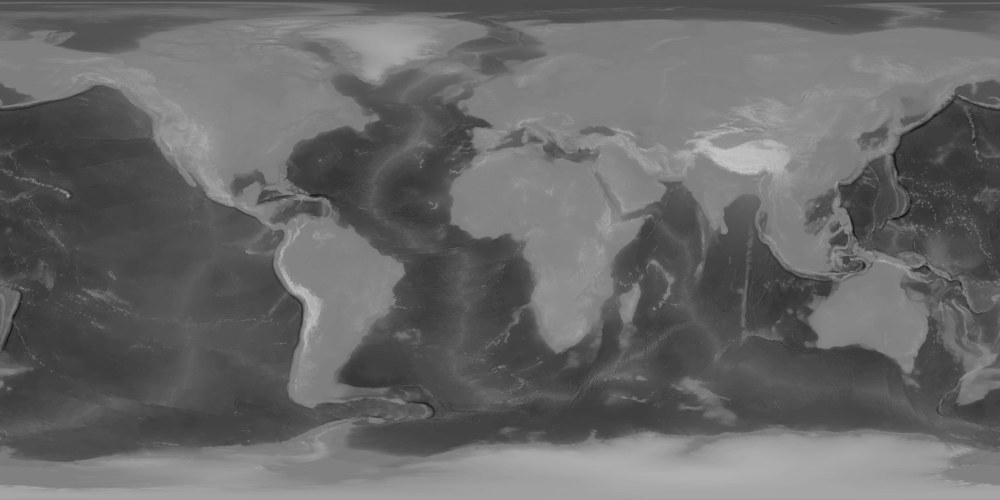

In [5]:
Image.fromarray(topobathy_arr)

In [6]:
topobathy_arr

array([[ 78,  78,  78, ...,  78,  78,  78],
       [ 78,  78,  78, ...,  78,  78,  78],
       [ 78,  78,  78, ...,  78,  78,  78],
       ...,
       [161, 161, 161, ..., 161, 161, 161],
       [161, 161, 161, ..., 161, 161, 161],
       [161, 161, 161, ..., 161, 161, 161]], dtype=uint8)

## Numpy


Get create lat and lon ranges to check size vs our image

In [7]:
lat_range = np.arange(-180.0, 180.0, 0.25)
lat_range = lat_range[:, None]

lon_range = np.arange(-360.0, 360.0, 0.25)
lon_range = lon_range[None, :]
lat_range.shape, lon_range.shape

((1440, 1), (1, 2880))

In [8]:
np.array(lat_range@lon_range).size

4147200

When comparing our data array to the topobathy image array, it appears that aspect ratio is the same, and that our data is a scaled down match in terms of what we'll need to convert to `pixels`

In [9]:
np.array((lat_range@lon_range).shape) / np.array(topobathy_arr.shape) 

array([0.53333333, 0.53333333])

In [10]:
1440 * 1/.5333333

2700.0001687500103

We will as well have to generate greyscale values as well 

## Connect to Postgres database

#In the postgres db, we have data fetched from the NOAA Wavewatch III forecasts for latitudes and longitudes at #intervals of roughly `0.25`. We want to fetch the swell data so that we can transform it into something useful for #creating a topobathy image.

In [11]:
query = """
SELECT
    COALESCE(swell, 0) as swell
FROM wave_forecast 
WHERE time = '2023-12-07 00:00:00+00' 
ORDER BY latitude DESC, longitude DESC 
LIMIT 50000;
"""

In [12]:
dbname = "surfing_data"
user = "postgres"
password = "your_password"
host = "localhost"

In [13]:
swell_arr = np.array([])
swell_arr.shape

(0,)

In [14]:
def query_database_in_batches(cursor, query, batch_size=10000):
    """Generator function to query the database in batches using a server-side cursor."""
    cursor.execute(query)
    while True:
        records = cursor.fetchmany(batch_size)
        if not records:
            break
        yield [item[0] for item in records]

In [15]:
# # Connect to your PostgreSQL database
# conn = pg.connect(
#     dbname=dbname,
#     user=user,
#     password=password,
#     host=host
# )
# conn.autocommit = True  # Required for server-side cursors


# swell_list = []
# # Create a server-side cursor
# with conn.cursor() as cursor:
#     with conn:
#         for batch_item in query_database_in_batches(cursor, query, batch_size=1000):
#             swell_list.append(batch_item)

# # Close the database connection
# conn.close()

In [17]:
((500000000 / 50000) * 18) / 60

3000.0

In [18]:
dummy_arr = (lat_range@lon_range)
dummy_arr.shape

(1440, 2880)

Normalize the array

In [19]:
np.set_printoptions(precision=2, suppress=True)

In [20]:
norm_arr = (dummy_arr - dummy_arr.min()) / (dummy_arr.max() - dummy_arr.min())

In [21]:
dummy_image = Image.fromarray(norm_arr, 'L')

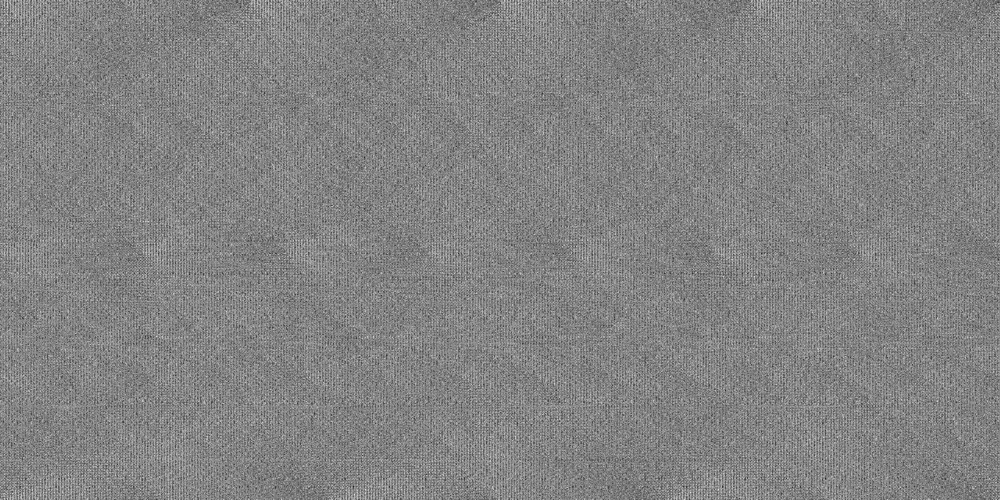

In [22]:
dummy_image

In [23]:
upscaled_image = dummy_image.resize(topobathy_arr.T.shape, Image.LANCZOS)

In [26]:
upscaled_image.size

(5400, 2700)

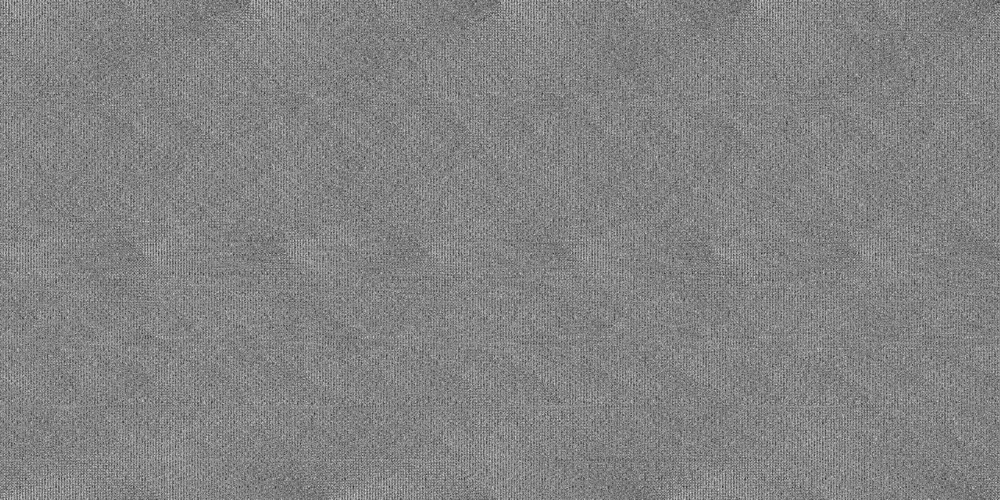

In [27]:
upscaled_image